In [40]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

## Reading the dataset

In [41]:
df = pd.read_csv("Online Retail Data Set.csv",encoding='iso-8859-1')

## Getting a picture of the dataset

In [42]:
df.shape #getting number of rows and columns

(541909, 8)

In [43]:
df.head() #getting first five rows of data

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,01-12-2010 08:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,01-12-2010 08:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,01-12-2010 08:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,01-12-2010 08:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,01-12-2010 08:26,3.39,17850.0,United Kingdom


In [44]:
df.describe() #getting statistical information of the dataset

,Quantity,UnitPrice,CustomerID
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611114,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


In [45]:
df.info() #getting basic picture of the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


## Removing duplicate records

In [46]:
df.duplicated().sum() #getting number of duplicate records i.e, number of duplicate rows

5268

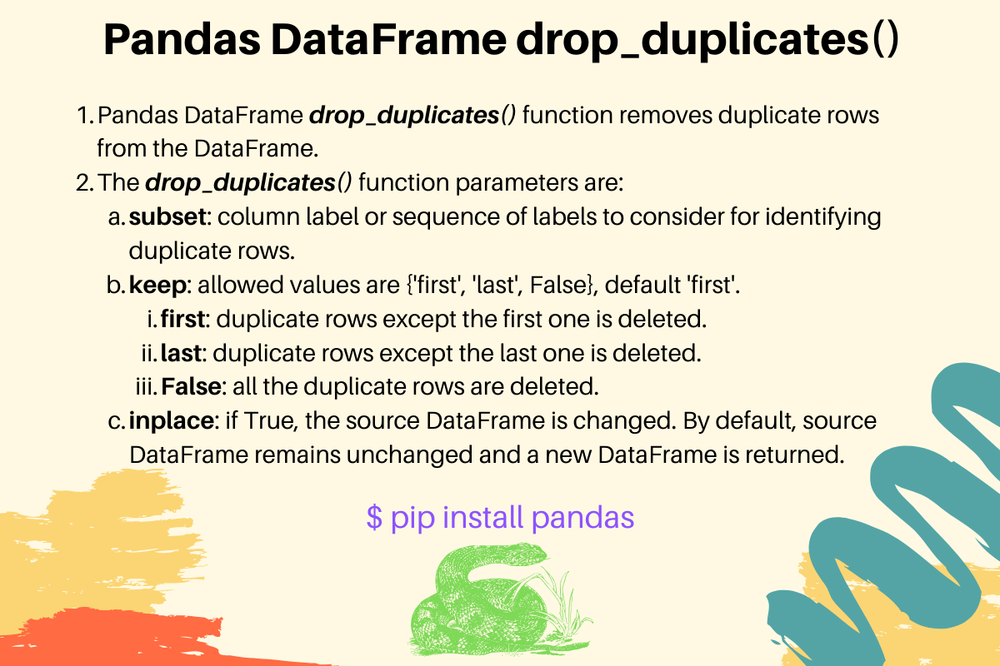

In [49]:
df.drop_duplicates(keep="first",inplace=True)

In [50]:
df.duplicated().sum() #checking if any duplicate records are left

0

## Replacing null values

In [51]:
df.isnull().sum() #getting number of null values in each column

InvoiceNo           0
StockCode           0
Description      1454
Quantity            0
InvoiceDate         0
UnitPrice           0
CustomerID     135037
Country             0
dtype: int64

In [52]:
copy = df.copy() #creating a copy of current dataframe

In [53]:
df['Description']=df['Description'].fillna('NaN') #Description column null values are replaced with 'NaN'
df['CustomerID']=df['CustomerID'].fillna(0) #CustomerID column null values are replaced with 0.

In [54]:
df.isnull().sum() #checking if any null values are left

InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
CustomerID     0
Country        0
dtype: int64

## Converting datatype of a column

In [55]:
type(df['InvoiceDate'])

pandas.core.series.Series

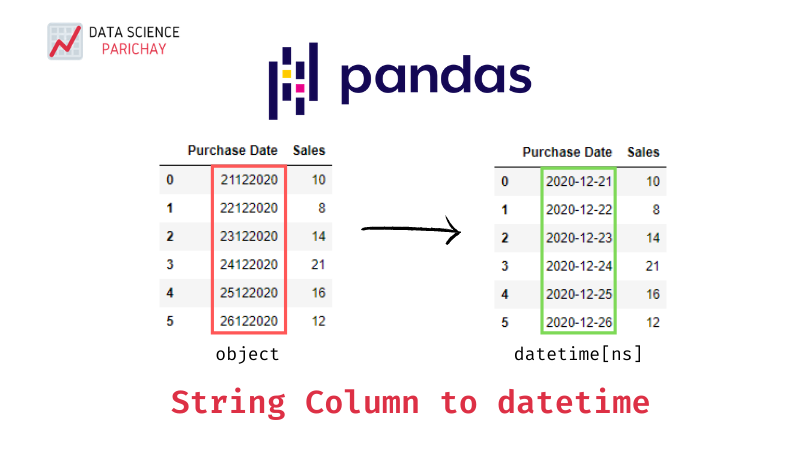

In [56]:
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate']) # Convert 'InvoiceDate' column to datetime

## Creating a new column

In [57]:
df['Revenue'] = df['Quantity'] * df['UnitPrice'] #revenue column is created which gets the product of quantity and unitprice columns respectively

In [59]:
df.head() #checking if revenue column was added

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Revenue
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-01-12 08:26:00,2.55,17850.0,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-01-12 08:26:00,2.75,17850.0,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34


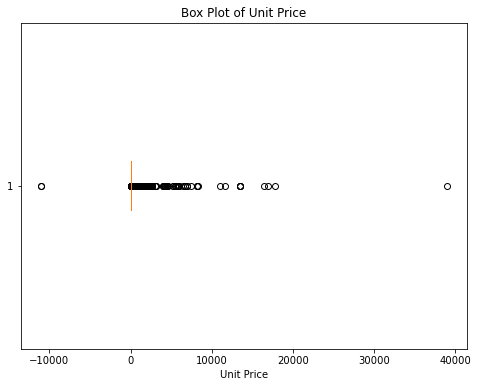

In [58]:
plt.figure(figsize=(8, 6))
plt.boxplot(df['UnitPrice'], vert=False)  # Set vert=False for a horizontal box plot
plt.title('Box Plot of Unit Price')
plt.xlabel('Unit Price')
plt.show()

In [59]:
negative_prices_df = df[df['UnitPrice'] < 0]

In [60]:
print(negative_prices_df)

       InvoiceNo StockCode      Description  Quantity         InvoiceDate  \
299983   A563186         B  Adjust bad debt         1 2011-12-08 14:51:00   
299984   A563187         B  Adjust bad debt         1 2011-12-08 14:52:00   

        UnitPrice  CustomerID         Country   Revenue  
299983  -11062.06         0.0  United Kingdom -11062.06  
299984  -11062.06         0.0  United Kingdom -11062.06  


In [61]:
# Filter out rows with negative unit prices and "Adjust bad debt" descriptions
filtered_df = df[(df['UnitPrice'] >= 0) & (~df['Description'].str.contains('Adjust bad debt'))]

In [62]:
filtered_df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country,Revenue
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-01-12 08:26:00,2.55,17850.0,United Kingdom,15.30
1,536365,71053,WHITE METAL LANTERN,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-01-12 08:26:00,2.75,17850.0,United Kingdom,22.00
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-01-12 08:26:00,3.39,17850.0,United Kingdom,20.34


In [63]:
filtered_df['UnitPrice'].min()

0.0

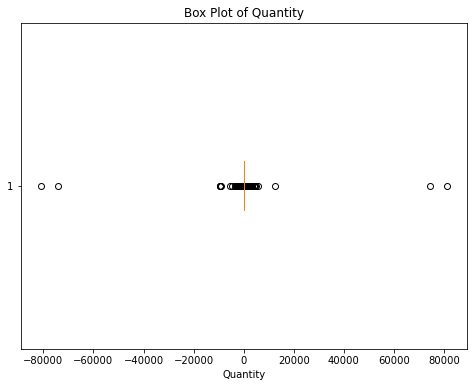

In [65]:
plt.figure(figsize=(8, 6))
plt.boxplot(df['Quantity'], vert=False)  # Set vert=False for a horizontal box plot
plt.title('Box Plot of Quantity')
plt.xlabel('Quantity')
plt.show()

In [66]:
filtered_df = df[df['Quantity'] >= 0]

In [67]:
filtered_df['Quantity'].min()

1

In [68]:
product_revenue = df.groupby('StockCode')['Revenue'].sum().sort_values(ascending=False)

In [70]:
product_revenue

StockCode
DOT             206245.480
22423           164459.490
47566            98243.880
85123A           97838.450
85099B           92175.790
                   ...    
BANK CHARGES     -7175.639
CRUK             -7933.430
B               -11062.060
M               -69034.190
AMAZONFEE      -221520.500
Name: Revenue, Length: 4070, dtype: float64

In [71]:
# Group the DataFrame by 'Description' and calculate the total revenue for each category
category_revenue = df.groupby('Description')['Revenue'].sum()

In [72]:
# Sort the categories by revenue in descending order
top_categories = category_revenue.sort_values(ascending=False)

In [73]:
# Display the top-performing categories
print(top_categories.head(10))

Description
DOTCOM POSTAGE                        206245.48
REGENCY CAKESTAND 3 TIER              164459.49
WHITE HANGING HEART T-LIGHT HOLDER     99612.42
PARTY BUNTING                          98243.88
JUMBO BAG RED RETROSPOT                92175.79
RABBIT NIGHT LIGHT                     66661.63
POSTAGE                                66230.64
PAPER CHAIN KIT 50'S CHRISTMAS         63715.24
ASSORTED COLOUR BIRD ORNAMENT          58792.42
CHILLI LIGHTS                          53746.66
Name: Revenue, dtype: float64


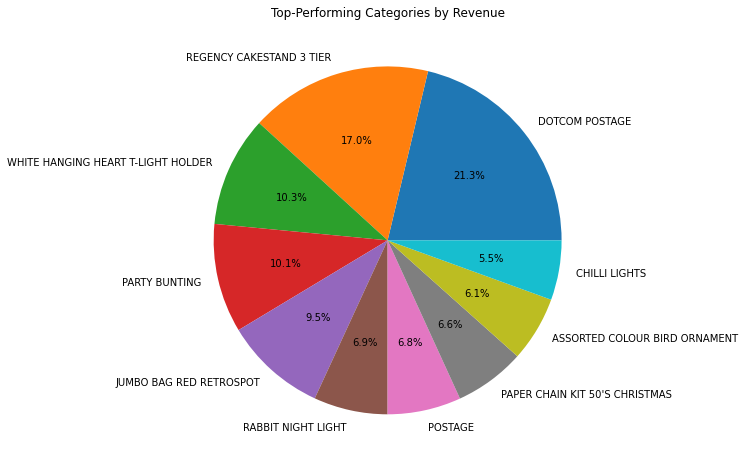

In [77]:
top_categories.head(10).plot(kind='pie', autopct='%1.1f%%', figsize=(8, 8))
plt.title('Top-Performing Categories by Revenue')
plt.ylabel('')
plt.show()

In [78]:
country_revenue = df.groupby('Country')['Revenue'].sum().sort_values(ascending=False)

In [79]:
country_revenue

Country
United Kingdom          8167128.184
Netherlands              284661.540
EIRE                     262993.380
Germany                  221509.470
France                   197317.110
Australia                137009.770
Switzerland               56363.050
Spain                     54756.030
Belgium                   40910.960
Sweden                    36585.410
Japan                     35340.620
Norway                    35163.460
Portugal                  29302.970
Finland                   22326.740
Channel Islands           20076.390
Denmark                   18768.140
Italy                     16890.510
Cyprus                    12858.760
Austria                   10154.320
Hong Kong                  9908.240
Singapore                  9120.390
Israel                     7901.970
Poland                     7213.140
Unspecified                4740.940
Greece                     4710.520
Iceland                    4310.000
Canada                     3666.380
Malta               

In [83]:
fig = px.choropleth(df, locations="Country", locationmode="country names", color="Revenue", scope="europe")

# Customize the map
fig.update_geos(projection_scale=5)
fig.update_layout(title="Revenue by Country")
fig.show()

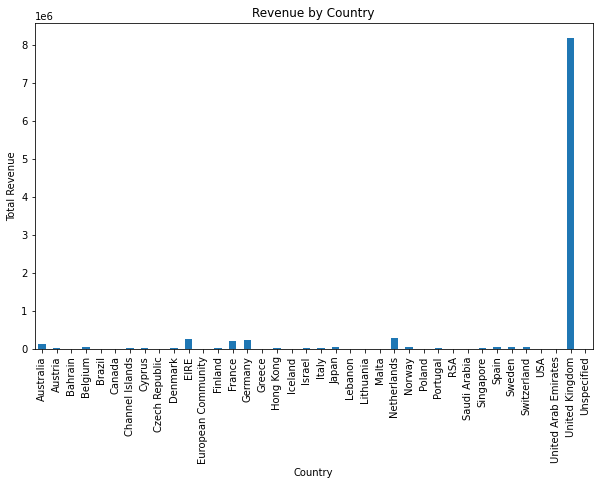

In [84]:
country_revenue = df.groupby('Country')['Revenue'].sum()

# Create a bar chart or horizontal bar chart
country_revenue.plot(kind='bar', figsize=(10, 6))
plt.title('Revenue by Country')
plt.xlabel('Country')
plt.ylabel('Total Revenue')
plt.show()